In [1]:
import os
if 'examples' in os.getcwd(): os.chdir('../')
print(os.getcwd())

/home/bernie40916/Nas/home/Project/DJtransGAN-dg-pipeline


In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
import torch
import random
from tqdm import tqdm
import matplotlib.pyplot as plt

from pipeline.config     import settings
from pipeline.utils      import load_audio, load_npy, load_json, random_samples, time_to_str, time_to_samples
from pipeline.utils      import wave_visualize, audio_visualize
from pipeline.mixability import get_seg_ids, get_cand_ids
from pipeline.mixability import match_pair_by_rule, match_pair_by_nn, sync_pair


For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
If you depend on functionality not listed there, please file an issue.

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
keep_dims is deprecated, use keepdims instead
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.
Instructions for updating:
Use keras.layers.max_pooling2d instead.
Instructions for updating:
Use tf.cast instead.


### Load Data

In [4]:
seg_dir    = os.path.join(settings.TRACK_DIR, 'seg')
audio_dir  = os.path.join(seg_dir, 'audio')
obj_dir    = os.path.join(seg_dir, 'obj')
meta_dir   = os.path.join(seg_dir, 'meta')
match_type = 'rule' # e.g: all, nn, rule, None
n_sample   = 20

seg_ids    = get_seg_ids()
src_id     = seg_ids[0]
cand_ids   = get_cand_ids(src_id, seg_ids)

### Check by Rule

In [5]:
if match_type not in ['all', 'rule']:
    matched_cand_ids = cand_ids
    print('Ignore rule purify')
else:
    matched_cand_ids = match_pair_by_rule(src_id, cand_ids)
    print(f'total: {len(cand_ids)}, matched: {len(matched_cand_ids)}')

total: 750, matched: 46


### Check by SEN

In [6]:
if match_type not in ['all', 'nn'] and len(matched_cand_ids) != 0:
    print('Ignore nn purify')
    best_cand_id = random_samples(matched_cand_ids, 1)[0]
else:
    best_cand_id = match_pair_by_nn(src_id, matched_cand_ids, n_sample=n_sample)

Ignore nn purify


### Load Obj

In [7]:
tgt_id    = best_cand_id 

src_obj   = load_npy(os.path.join(obj_dir, f'{src_id}.npy')).item()
src_audio = load_audio(os.path.join(audio_dir, f'{src_id}.wav'))

tgt_obj   = load_npy(os.path.join(obj_dir, f'{tgt_id}.npy')).item()
tgt_audio = load_audio(os.path.join(audio_dir, f'{tgt_id}.wav'))

### Visualize

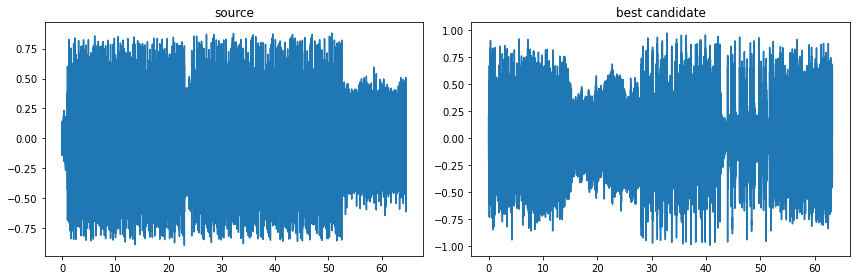

In [8]:
fig, axs = plt.subplots(1, 2, figsize=(12, 4))
wave_visualize(src_audio, axs[0], title='source')
wave_visualize(tgt_audio, axs[1], title='best candidate')
plt.tight_layout()
plt.show()

In [9]:
print('source: ')
audio_visualize(src_audio)

print('best candidate: ')
audio_visualize(tgt_audio)

source: 


best candidate: 


### Manipulate

In [10]:
pair_obj, pair_audio = sync_pair(src_obj, tgt_obj, src_audio, tgt_audio)

> /home/bernie40916/Nas/home/Project/DJtransGAN-dg-pipeline/pipeline/mixability/sync.py(19)sync_cue()
     17     synced        = splited[begin_idx]
     18     import pdb;pdb.set_trace()
---> 19     tgt_cue       = [tgt_cue[0], 
     20                      tgt_cue[0]+(src_cue[1]-src_cue[0])]
     21 



ipdb>  continue


In [13]:
print('source: ')
audio_visualize(pair_audio['prev'])

print('target: ')
audio_visualize(pair_audio['next'])

source: 


target: 


### Beat Sync Checked

0:49.74
1:4.52


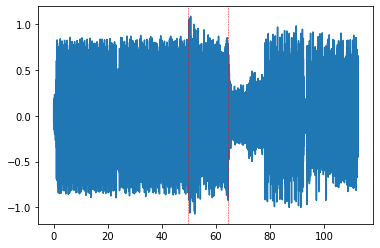

In [14]:
# Mix

prev_cue_sample  = [time_to_samples(c) for c in pair_obj['prev']['cue']]
next_cue_sample  = [time_to_samples(c) for c in pair_obj['next']['cue']]

prev_other_audio = pair_audio['prev'][:, :prev_cue_sample[0]]
prev_cue_audio   = pair_audio['prev'][:, prev_cue_sample[0]:prev_cue_sample[1]]
next_cue_audio   = pair_audio['next'][:, next_cue_sample[0]:next_cue_sample[0]+prev_cue_audio.size(-1)]
next_other_audio = pair_audio['next'][:, next_cue_sample[0]+prev_cue_audio.size(-1):]

stacked          = prev_other_audio
stacked          = torch.cat((stacked, prev_cue_audio+next_cue_audio), 1)
stacked          = torch.cat((stacked, next_other_audio), 1)

wave_visualize(stacked, plt, timestamps=pair_obj['prev']['cue'])

for c in (pair_obj['prev']['cue']):
    print(time_to_str(c))

audio_visualize(stacked)